In [1]:
import numpy as np 
import pandas as pd 


import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

/kaggle/input/tomato-leaf-diseases-dataset-for-object-detection/Tomato leaf diseases dataset for Object Detection/README_es.txt
/kaggle/input/tomato-leaf-diseases-dataset-for-object-detection/Tomato leaf diseases dataset for Object Detection/README_en.txt
/kaggle/input/tomato-leaf-diseases-dataset-for-object-detection/Tomato leaf diseases dataset for Object Detection/Dataset without augmentation/README.dataset.txt
/kaggle/input/tomato-leaf-diseases-dataset-for-object-detection/Tomato leaf diseases dataset for Object Detection/Dataset without augmentation/README.roboflow.txt
/kaggle/input/tomato-leaf-diseases-dataset-for-object-detection/Tomato leaf diseases dataset for Object Detection/Dataset without augmentation/data.yaml
/kaggle/input/tomato-leaf-diseases-dataset-for-object-detection/Tomato leaf diseases dataset for Object Detection/Dataset without augmentation/valid/labels/V006_77_1_18_11_03_13_2_9605w_20200925_44_jpg.rf.0fae5065fe5010a95764d301901b524d.txt
/kaggle/input/tomato-lea

In [2]:
# ------------------------------------------------------------
# 1️⃣ Setup & Imports
# ------------------------------------------------------------
!pip install -q ultralytics ttach > /dev/null
import kagglehub
import os
import random
import yaml
import cv2
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from PIL import Image
from ultralytics import YOLO

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
bigframes 2.12.0 requires google-cloud-bigquery-storage<3.0.0,>=2.30.0, which is not installed.
mkl-umath 0.1.1 requires numpy<1.27.0,>=1.26.4, but you have numpy 2.2.6 which is incompatible.
mkl-random 1.2.4 requires numpy<1.27.0,>=1.26.4, but you have numpy 2.2.6 which is incompatible.
mkl-fft 1.3.8 requires numpy<1.27.0,>=1.26.4, but you have numpy 2.2.6 which is incompatible.
numba 0.60.0 requires numpy<2.1,>=1.22, but you have numpy 2.2.6 which is incompatible.
datasets 4.4.1 requires pyarrow>=21.0.0, but you have pyarrow 19.0.1 which is incompatible.
ydata-profiling 4.17.0 requires numpy<2.2,>=1.16.0, but you have numpy 2.2.6 which is incompatible.
google-colab 1.0.0 requires notebook==6.5.7, but you have notebook 6.5.4 which is incompatible.
google-colab 1.0.0 requires pandas==2.2.2, but you have pandas 2.2

In [3]:
import shutil

# Original read-only dataset path
src_path = "/kaggle/input/tomato-leaf-diseases-dataset-for-object-detection"

# Writable path for Kaggle session
dst_path = "/kaggle/working/tomato_dataset"

# Copy entire dataset to writable folder
if not os.path.exists(dst_path):
    shutil.copytree(src_path, dst_path)

print("Dataset copied to:", dst_path)

Dataset copied to: /kaggle/working/tomato_dataset


# 📂 Dataset Integrity Check

This step verifies that the **Tomato Leaf Disease Object Detection dataset** is correctly organized in the Kaggle working directory.

**Dataset Path**
- `/kaggle/working/tomato_dataset/Tomato leaf diseases dataset for Object Detection/Dataset with augmentation`

**Checks Performed**
- Confirms the presence of three splits:
  - **train**
  - **valid**
  - **test**
- Ensures each split contains:
  - an `images` directory
  - a `labels` directory
- Reports the number of images and labels in each split

**Why This Is Important**
- Validates YOLO-style dataset structure  
- Prevents missing-file errors during training  
- Confirms data readiness before model training and evaluation


In [4]:
dataset_root = "/kaggle/working/tomato_dataset/Tomato leaf diseases dataset for Object Detection/Dataset with augmentation"

for split in ['train', 'valid', 'test']:
    img_dir = os.path.join(dataset_root, split, 'images')
    lbl_dir = os.path.join(dataset_root, split, 'labels')
    assert os.path.exists(img_dir), f"Missing {img_dir}"
    assert os.path.exists(lbl_dir), f"Missing {lbl_dir}"
    print(f"📂 {split}: {len(os.listdir(img_dir))} images, {len(os.listdir(lbl_dir))} labels")

📂 train: 9730 images, 9730 labels
📂 valid: 659 images, 659 labels
📂 test: 420 images, 420 labels


# 🛠️ Fixing and Saving 

`data.yaml`

This step updates the dataset configuration file so it correctly points to the dataset locations inside the Kaggle working directory.

**What is done**
- Loads the existing `data.yaml`
- Corrects the paths for:
  - `train` images
  - `val` (validation) images
  - `test` images
- Saves the corrected configuration to:
  - `/kaggle/working/data.yaml`

**Why this is important**
- Ensures the training pipeline can locate all dataset splits
- Prevents path-related errors during model training
- Makes the configuration compatible with Kaggle’s writable environment

**Additional check**
- Displays the list of class names to confirm label consistency

After this step, the dataset configuration is fully ready for training.


In [5]:
#3️⃣ Fix & Save data.yaml
# ------------------------------------------------------------
yaml_path = os.path.join(dataset_root, "data.yaml")
with open(yaml_path, 'r') as f:
    data_config = yaml.safe_load(f)

data_config['train'] = os.path.join(dataset_root, 'train', 'images')
data_config['val'] = os.path.join(dataset_root, 'valid', 'images')
data_config['test'] = os.path.join(dataset_root, 'test', 'images')

corrected_yaml = '/kaggle/working/data.yaml'
os.makedirs(os.path.dirname(corrected_yaml), exist_ok=True)
with open(corrected_yaml, 'w') as f:
    yaml.dump(data_config, f)

print("✅ Corrected data.yaml saved to:", corrected_yaml)

class_names = data_config["names"]
print(f"✅ Class names: {class_names}")

✅ Corrected data.yaml saved to: /kaggle/working/data.yaml
✅ Class names: ['Early Blight', 'Healthy', 'Late Blight', 'Leaf Miner', 'Leaf Mold', 'Mosaic Virus', 'Septoria', 'Spider Mites', 'Yellow Leaf Curl Virus']


## 👀 YOLO Dataset Visualization

This step visually inspects the YOLO-formatted dataset to ensure that **bounding boxes and class labels** are correctly aligned with the images.

**What this visualization does**
- Selects a dataset split (e.g., `train`, `val`, or `test`)
- Randomly samples a few labeled images
- Draws bounding boxes from YOLO annotations onto the images
- Displays class names on each detected object

**Why this is important**
- Verifies annotation correctness before training
- Confirms bounding box coordinates are properly normalized
- Helps catch label mismatches or corrupted annotations early

**Output**
- A small set of images with bounding boxes and class names overlaid
- Each image title shows the dataset split and file name

This visual sanity check ensures the dataset is ready for reliable YOLO training.


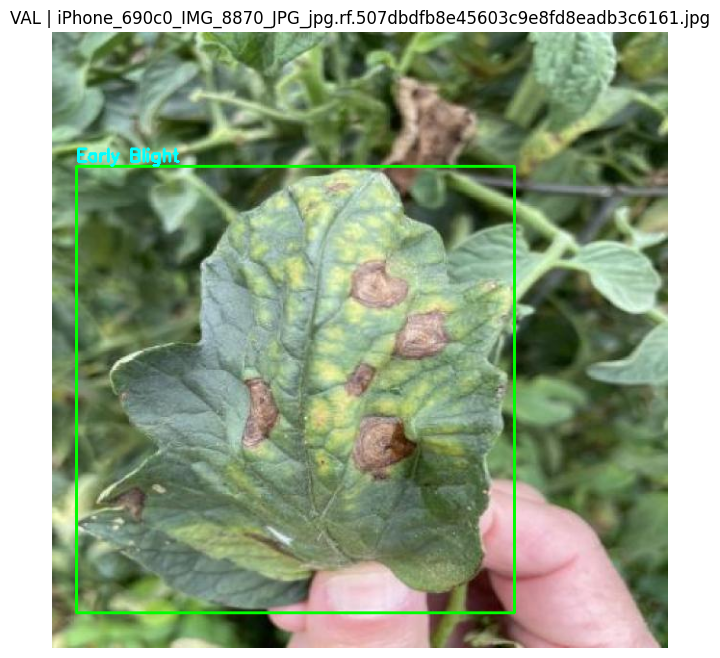

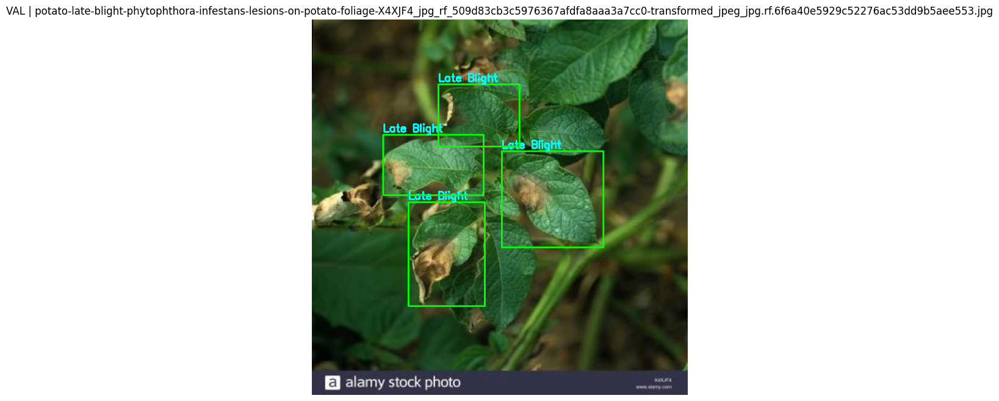

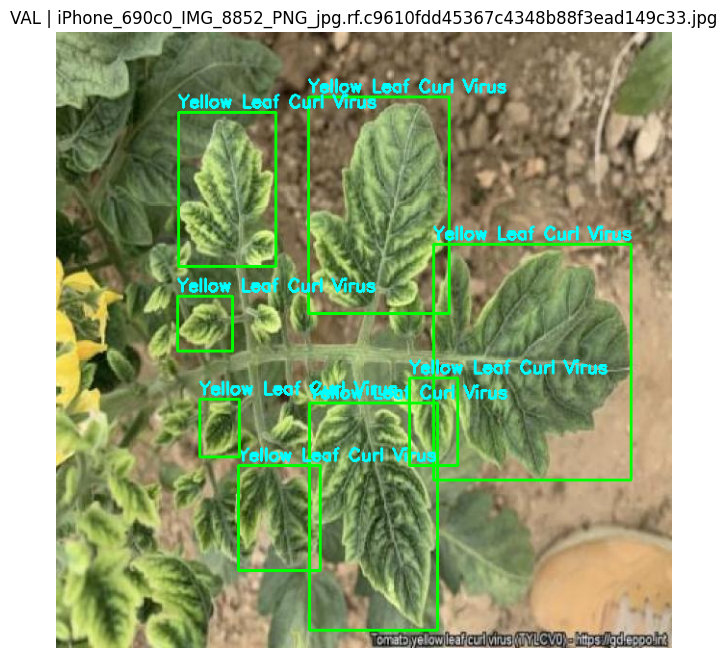

In [6]:
# ------------------------------------------------------------
# 4️⃣ YOLO Dataset Visualization
# ------------------------------------------------------------
def visualize_yolo_split(split_name, num_images=3):
    image_dir = Path(data_config[split_name])
    label_dir = image_dir.parent / "labels"

    img_files = list(image_dir.glob("*.jpg")) + list(image_dir.glob("*.png"))
    valid_imgs = [img for img in img_files if (label_dir / f"{img.stem}.txt").exists()]

    if not valid_imgs:
        print(f"⚠️ No labeled images found in {image_dir}")
        return

    random.shuffle(valid_imgs)
    for img_path in valid_imgs[:num_images]:
        label_path = label_dir / f"{img_path.stem}.txt"
        img = cv2.imread(str(img_path))
        h, w = img.shape[:2]

        with open(label_path, "r") as f:
            for line in f.readlines():
                parts = line.strip().split()
                if len(parts) < 5: continue
                cls, x, y, bw, bh = map(float, parts[:5])
                cls = int(cls)
                x1, y1 = int((x - bw/2)*w), int((y - bh/2)*h)
                x2, y2 = int((x + bw/2)*w), int((y + bh/2)*h)
                cv2.rectangle(img, (x1, y1), (x2, y2), (0,255,0), 2)
                cv2.putText(img, class_names[cls], (x1, y1-5),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255,255,0), 2)

        plt.figure(figsize=(8,8))
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis("off")
        plt.title(f"{split_name.upper()} | {img_path.name}")
        plt.show()

visualize_yolo_split("val", num_images=3)

## 🚀 YOLOv12 Teacher Model Training

This step trains a **pretrained YOLOv12 nano (teacher) model** on the tomato leaf disease object detection dataset.

**Training setup**
- Model: `yolo12n.pt` (pretrained)
- Image size: `640 × 640`
- Batch size: `16`
- Epochs: `40` 
- Device: GPU (`device = 0`)
- Project directory:
  - `/kaggle/working/tomato_yolov12_train`
- Run name:
  - `teacher`

**What happens**
- The model is fine-tuned on the custom dataset defined in `data.yaml`
- Training logs, checkpoints, and results are saved automatically
- The best-performing model weights are tracked during training

**Output**
- Confirmation that training has completed successfully
- The directory where results are saved
- The path to the best model checkpoint

This trained teacher model will be used as a strong baseline and can later support knowledge distillation or further optimization.


In [7]:
from ultralytics import YOLO

teacher = YOLO("yolo12n.pt")  # pretrained

results = teacher.train(
    data    = str(yaml_path),
    epochs  = 50,
    imgsz   = 640,
    batch   = 16,
    project = "/kaggle/working/tomato_yolov12_train",
    name    = "teacher",
    device  = 0
)

print("\n✅ Training complete.")
print("📁 Save directory:", results.save_dir)
print("🏆 Best model path:", teacher.trainer.best)


Ultralytics 8.3.237 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/kaggle/working/tomato_dataset/Tomato leaf diseases dataset for Object Detection/Dataset with augmentation/data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo12n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=teacher, nbs=64, nms=False, opset=None, o

/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all        659       1785      0.924      0.877       0.95      0.861
          Early Blight        134        163      0.913      0.899      0.958      0.888
               Healthy         91        288      0.902      0.895      0.954      0.856
           Late Blight        115        175      0.933      0.943      0.959      0.882
            Leaf Miner        127        174      0.965      0.983      0.993      0.924
             Leaf Mold        106        215      0.902      0.817      0.933      0.839
          Mosaic Virus        152        186      0.965      0.866      0.956      0.902
              Septoria        104        196      0.904      0.817      0.937      0.836
          Spider Mites         76        205      0.967      0.932      0.981      0.917
Yellow Leaf Curl Virus         64        183      0.866      0.744       0.88      0.702
Speed: 0.2ms preprocess, 2.9ms inference, 0.0ms loss, 1.2ms postprocess per image
Results saved to /kaggle/wor

## 🏷️ Pseudo-Label Generation on Unlabeled Images

This step uses the trained **YOLOv12 teacher model** to generate pseudo-labels for unlabeled images.

**Process**
- Source folder:  
  `/kaggle/working/tomato_dataset/Tomato leaf diseases dataset for Object Detection/Dataset with augmentation/train/images`
- Confidence threshold: `0.7` (only predictions with ≥70% confidence are kept)
- Predictions include:
  - Bounding boxes
  - Class labels
- Results are saved in YOLO format (`.txt`) along with confidence scores

**Output**
- Pseudo-labels saved to:  
  `/kaggle/working/tomato_yolov12_train/teacher/raw/labels`
- These labels can now be used to expand the training dataset or for semi-supervised learning

**Purpose**
- Leverages the teacher model to annotate unlabeled images automatically  
- Provides high-confidence training data for student model training


In [8]:
# TRUE unlabeled image folder
UNLABELED = "/kaggle/working/tomato_dataset/Tomato leaf diseases dataset for Object Detection/Dataset with augmentation/train/images"

results = teacher.predict(
    source    = UNLABELED,
    save_txt  = True,
    save_conf = True,
    conf      = 0.7,
    project   = "/kaggle/working/tomato_yolov12_train/teacher",
    name      = "raw",
    device    = 0
)

print("\n✅ Pseudo-label generation complete.")
print("📁 Labels saved to:")
print("/kaggle/working/tomato_yolov12_train/teacher/raw/labels")




WARNING ⚠️ 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

image 1/9730 /kaggle/working/tomato_dataset/Tomato leaf diseases dataset for Object Detection/Dataset with augmentation/train/images/02cb8c4e-4542-4020-bb46-025de54d97ae___PSU_CG-2098_JPG_jpg.rf.35161916e49198873b66310a1e87ef22.jpg: 640x640 1 Mosaic Virus, 12.1ms
image 2/9730 /kaggle/working/tomato_dataset/Tomato leaf diseases dataset for Object Detection/Dataset with augmentation/train/images/02cb8c4e-4542-4020-bb46-025de54d97ae___PSU_CG-2098_JPG_jpg.

## 👨‍🎓 Creating the Student Dataset for Semi-Supervised Learning

This step prepares a **student dataset** by combining ground-truth labels with pseudo-labels generated by the teacher model.

**Dataset structure**
- Source splits:
  - Validation: `valid/images` + `valid/labels` → copied directly
  - Training: `train/images` + `train/labels` → ground-truth labels augmented with pseudo-labels
- Pseudo-label directory:  
  `/kaggle/working/tomato_yolov12_train/pseudo/raw/labels`
- Student dataset output:  
  `/kaggle/working/2_student`
  - `train/images` and `train/labels`
  - `valid/images` and `valid/labels`

**Steps performed**
1. Ensure all required directories exist
2. Copy validation images and labels to student dataset
3. Copy training images and labels:
   - Ground-truth labels are copied first
   - Pseudo-labels are appended if available
4. Write a new `dataset.yaml` for the student dataset with:
   - Correct paths
   - Number of classes (`nc`)
   - Class names

**Purpose**
- Creates a combined dataset for **semi-supervised training**  
- Allows the student model to learn from both original and pseudo-labeled data
- Ensures compatibility with YOLO training pipelines


In [9]:
# ------------------------------------------------------------
# Define dataset split root based on your script
# ------------------------------------------------------------
SPLIT = Path("/kaggle/working/tomato_dataset/Tomato leaf diseases dataset for Object Detection/Dataset with augmentation")

# Pseudo-label directory from your script
PSEUDO_DIR = Path("/kaggle/working/tomato_yolov12_train/pseudo/raw/labels")

# Student dataset output folder
STUDENT_ROOT = Path("/kaggle/working/2_student")
STU_TRAIN = STUDENT_ROOT / "train"
STU_VALID = STUDENT_ROOT / "valid"


# ------------------------------------------------------------
# Ensure required directories exist
# ------------------------------------------------------------
(STU_VALID/"images").mkdir(parents=True, exist_ok=True)
(STU_VALID/"labels").mkdir(parents=True, exist_ok=True)
(STU_TRAIN/"images").mkdir(parents=True, exist_ok=True)
(STU_TRAIN/"labels").mkdir(parents=True, exist_ok=True)



# ------------------------------------------------------------
# Copy VALID → student/valid
# ------------------------------------------------------------
for src in (SPLIT/"valid"/"images").iterdir():
    shutil.copy(src, STU_VALID/"images"/src.name)

    lbl = SPLIT/"valid"/"labels"/f"{src.stem}.txt"
    shutil.copy(lbl, STU_VALID/"labels"/f"{src.stem}.txt")



# ------------------------------------------------------------
# Copy TRAIN → student/train (GT + pseudo-labels)
# ------------------------------------------------------------
for src in (SPLIT/"train"/"images").iterdir():
    # Copy image
    shutil.copy(src, STU_TRAIN/"images"/src.name)

    # Ground-truth label
    gt = SPLIT/"train"/"labels"/f"{src.stem}.txt"
    dst = STU_TRAIN/"labels"/f"{src.stem}.txt"

    shutil.copy(gt, dst)   # Write GT first

    # Append pseudo-labels if exist
    pseudo = PSEUDO_DIR / f"{src.stem}.txt"
    if pseudo.exists():
        with open(dst, "a") as d, open(pseudo) as p:
            d.write(p.read())



# ------------------------------------------------------------
# Write student dataset.yaml
# ------------------------------------------------------------
stu_yaml = {
    'path': str(STUDENT_ROOT),
    'train': 'train/images',
    'val':   'valid/images',
    'nc':    len(class_names),
    'names': class_names
}

(STUDENT_ROOT/"dataset.yaml").write_text(yaml.dump(stu_yaml))

print("Student dataset.yaml saved to:", STUDENT_ROOT/"dataset.yaml")


Student dataset.yaml saved to: /kaggle/working/2_student/dataset.yaml


## 🎓 Training and Evaluating the Student Model

This step trains a **YOLOv12 student model** using the combined dataset (ground-truth + pseudo-labels) and evaluates its performance on the test set.

**Student Model Training**
- Model: `yolo12n.pt` (pretrained)
- Dataset: Student dataset (`dataset.yaml` with pseudo-labels)
- Image size: 640 × 640
- Batch size: 8
- Epochs: 35 
- Project folder: `/kaggle/working/2_student`
- Run name: `student`

**Evaluation**
- Test dataset: Original labeled test split (from original `data.yaml`)
- Batch size: 4
- Outputs metrics such as:
  - mAP (mean Average Precision)
  - Precision
  - Recall
  - F1 score

**Purpose**
- Fine-tunes the student model with both ground-truth and pseudo-labeled data  
- Evaluates generalization on unseen test images  
- Provides a measure of the effectiveness of the semi-supervised learning approach


In [10]:
# -----------------------------
# 8. Train Student Model
# -----------------------------
student = YOLO("yolo12n.pt")

student_yaml = STUDENT_ROOT / "dataset.yaml"     # student dataset YAML

_ = student.train(
    data   = str(student_yaml),
    epochs = 50,
    imgsz  = 640,
    batch  = 8,
    project= str(STUDENT_ROOT),
    name   = "student",
    device = 0
)


# -----------------------------
# 9. Evaluate Student on TEST set
# -----------------------------
# Use your ORIGINAL YAML (you said this one is correct)
test_yaml = yaml_path

metrics = student.val(
    data   = str(test_yaml),
    split  = "test",
    imgsz  = 640,
    batch  = 4,
    device = 0
)

print(metrics)


Ultralytics 8.3.237 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=8, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/kaggle/working/2_student/dataset.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo12n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=student, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0

/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all        659       1785      0.923      0.876      0.946      0.858
          Early Blight        134        163      0.927      0.896      0.962      0.885
               Healthy         91        288      0.916      0.868      0.948      0.847
           Late Blight        115        175      0.916       0.92      0.967      0.889
            Leaf Miner        127        174      0.975      0.994      0.992      0.922
             Leaf Mold        106        215      0.897      0.805      0.915      0.825
          Mosaic Virus        152        186      0.953      0.871      0.948      0.906
              Septoria        104        196      0.945      0.837      0.947      0.854
          Spider Mites         76        205      0.965      0.932      0.988      0.916
Yellow Leaf Curl Virus         64        183      0.809      0.762      0.848      0.676
Speed: 0.2ms preprocess, 3.1ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to /kaggle/wor

/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all        420       1578      0.982       0.96      0.989      0.952
          Early Blight        135        162      0.991      0.969      0.993      0.967
               Healthy         57        108      0.962       0.87      0.974      0.907
           Late Blight        189        261      0.992      0.996      0.993      0.966
            Leaf Miner        122        146      0.993      0.979      0.992       0.95
             Leaf Mold        168        222      0.977      0.959      0.989      0.949
          Mosaic Virus        172        220          1      0.935      0.993       0.95
              Septoria        143        174      0.996          1      0.995       0.98
          Spider Mites         98        111      0.992      0.991      0.995      0.981
Yellow Leaf Curl Virus        116        174      0.937       0.94      0.978      0.916
Speed: 1.1ms preprocess, 5.2ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to /kaggle/wor

## 📊 Teacher vs Student Model Evaluation

This step compares the performance of the **trained teacher** and **student** YOLOv12 models on the **test set**.

**Models evaluated**
- Teacher: `/kaggle/working/tomato_yolov12_train/teacher/weights/best.pt`
- Student: `/kaggle/working/2_student/student/weights/best.pt`

**Evaluation metrics**
- **Precision** – accuracy of predicted bounding boxes
- **Recall** – proportion of true objects detected
- **mAP@0.5** – mean Average Precision at IoU threshold 0.5
- **mAP@0.5:0.95** – mean Average Precision across multiple IoU thresholds
- **F1-score** – harmonic mean of precision and recall

**Purpose**
- Quantifies the impact of pseudo-labeling and semi-supervised training
- Compares teacher and student performance to assess knowledge transfer
- Identifies strengths and weaknesses of each model on unseen test data

**Output**
- A side-by-side comparison table of teacher vs student metrics for easy interpretation


In [11]:
# ------------------------------------------------------------
# 6️⃣ Evaluate the trained model
# ------------------------------------------------------------

from ultralytics import YOLO

# ------------------------------------------------------------
# Paths
# ------------------------------------------------------------
TEACHER_BEST = "/kaggle/working/tomato_yolov12_train/teacher/weights/best.pt"
STUDENT_BEST = "/kaggle/working/2_student/student/weights/best.pt"

# ------------------------------------------------------------
# Helper function for evaluation
# ------------------------------------------------------------
def evaluate_model(model_path, model_name):
    model = YOLO(model_path)

    metrics = model.val(
        data   = yaml_path,   # ORIGINAL dataset.yaml
        split  = "test",
        imgsz  = 640,
        batch  = 16,
        device = 0,
        workers= 2
    )

    r = metrics.results_dict

    precision = (
        r.get("metrics/precision(B)") or
        r.get("metrics/precision", 0)
    )

    recall = (
        r.get("metrics/recall(B)") or
        r.get("metrics/recall", 0)
    )

    mAP50 = (
        r.get("metrics/mAP50(B)") or
        r.get("metrics/mAP50", 0)
    )

    mAP5095 = (
        r.get("metrics/mAP50-95(B)") or
        r.get("metrics/mAP50-95", 0)
    )

    f1 = (
        2 * precision * recall / (precision + recall)
        if (precision + recall) > 0 else 0
    )

    return {
        "Model": model_name,
        "Precision": precision,
        "Recall": recall,
        "mAP@0.5": mAP50,
        "mAP@0.5:0.95": mAP5095,
        "F1-score": f1
    }

# ------------------------------------------------------------
# Run evaluation
# ------------------------------------------------------------
teacher_metrics = evaluate_model(TEACHER_BEST, "Teacher")
student_metrics = evaluate_model(STUDENT_BEST, "Student")

# ------------------------------------------------------------
# Print comparison
# ------------------------------------------------------------
print("\n📊 Teacher vs Student Evaluation (TEST set)\n")

for k in teacher_metrics:
    if k != "Model":
        print(f"{k:<15}: "
              f"Teacher = {teacher_metrics[k]:.4f} | "
              f"Student = {student_metrics[k]:.4f}")


Ultralytics 8.3.237 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
YOLOv12n summary (fused): 159 layers, 2,558,483 parameters, 0 gradients, 6.3 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 978.8±458.9 MB/s, size: 54.4 KB)
val: Scanning /kaggle/working/tomato_dataset/Tomato leaf diseases dataset for Object Detection/Dataset with augmentation/test/labels.cache... 420 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 420/420 815.9Kit/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 27/27 6.0it/s 4.5s


/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all        420       1578      0.982      0.958      0.989      0.951
          Early Blight        135        162      0.981      0.945      0.988      0.964
               Healthy         57        108       0.98      0.895      0.981      0.903
           Late Blight        189        261       0.99      0.996      0.995      0.966
            Leaf Miner        122        146      0.986       0.99      0.993      0.954
             Leaf Mold        168        222      0.965      0.946      0.983      0.939
          Mosaic Virus        172        220          1      0.947      0.994      0.956
              Septoria        143        174       0.99      0.994      0.995      0.984
          Spider Mites         98        111      0.988      0.991       0.99      0.979
Yellow Leaf Curl Virus        116        174      0.958      0.917      0.981      0.919
Speed: 1.2ms preprocess, 3.6ms inference, 0.0ms loss, 1.9ms postprocess per image
Results saved to /kaggle/wor

/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all        420       1578      0.982       0.96      0.989      0.952
          Early Blight        135        162      0.991      0.969      0.993      0.967
               Healthy         57        108      0.962       0.87      0.974      0.907
           Late Blight        189        261      0.992      0.996      0.993      0.966
            Leaf Miner        122        146      0.993      0.979      0.992       0.95
             Leaf Mold        168        222      0.977      0.959      0.989      0.949
          Mosaic Virus        172        220          1      0.935      0.993       0.95
              Septoria        143        174      0.996          1      0.995       0.98
          Spider Mites         98        111      0.992      0.991      0.995      0.981
Yellow Leaf Curl Virus        116        174      0.937       0.94      0.978      0.916
Speed: 1.6ms preprocess, 3.8ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to /kaggle/wor

## 📈 Training Metrics Visualization

This step plots **loss curves** and **mAP metrics** for both the teacher and student YOLOv12 models, allowing visual inspection of training progress and performance.

**What is visualized**
1. **Training & Validation Losses**
   - Box loss
   - Class loss
   - DFL (Distribution Focal Loss)
2. **Mean Average Precision (mAP)**
   - mAP@0.5
   - mAP@0.5:0.95

**Purpose**
- Compare learning dynamics between teacher and student models
- Identify underfitting, overfitting, or unstable training behavior
- Track improvement in detection performance over epochs

**Files used**
- Teacher: `/kaggle/working/tomato_yolov12_train/teacher/results.csv`
- Student: `/kaggle/working/2_student/student/results.csv`

**Outcome**
- Two side-by-side plots for each model:
  - Loss curves across epochs
  - mAP progression across epochs

This visualization helps interpret training effectiveness and guides hyperparameter tuning or model adjustments.



📊 Displaying metrics for: Teacher Model
Columns in results.csv: ['epoch', 'time', 'train/box_loss', 'train/cls_loss', 'train/dfl_loss', 'metrics/precision(B)', 'metrics/recall(B)', 'metrics/mAP50(B)', 'metrics/mAP50-95(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss', 'lr/pg0', 'lr/pg1', 'lr/pg2']


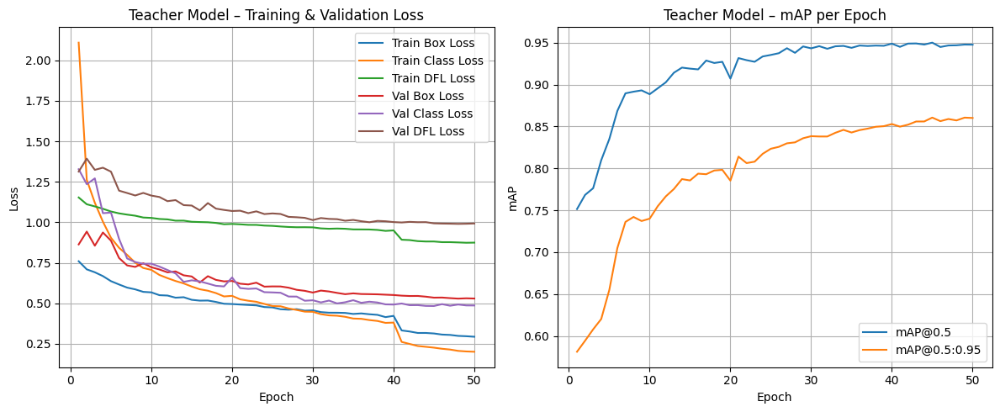


📊 Displaying metrics for: Student Model
Columns in results.csv: ['epoch', 'time', 'train/box_loss', 'train/cls_loss', 'train/dfl_loss', 'metrics/precision(B)', 'metrics/recall(B)', 'metrics/mAP50(B)', 'metrics/mAP50-95(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss', 'lr/pg0', 'lr/pg1', 'lr/pg2']


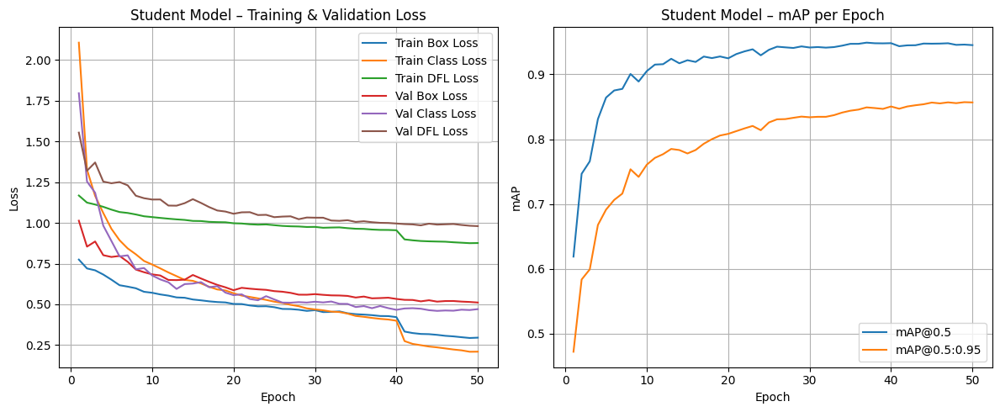


✅ Metric display complete for Teacher and Student.


In [12]:
import os
import pandas as pd
import matplotlib.pyplot as plt

# ------------------------------------------------------------
# Helper function to plot metrics from results.csv
# ------------------------------------------------------------
def plot_results(results_path, title_prefix):
    print(f"\n📊 Displaying metrics for: {title_prefix}")

    if not os.path.exists(results_path):
        print(f"⚠️ Results file not found at {results_path}")
        return

    results_df = pd.read_csv(results_path)

    # Show available columns (useful for debugging)
    print("Columns in results.csv:", results_df.columns.tolist())

    # Handle YOLO metric name changes
    map50_col = (
        "metrics/mAP50"
        if "metrics/mAP50" in results_df.columns
        else "metrics/mAP50(B)"
    )

    map5095_col = (
        "metrics/mAP50-95"
        if "metrics/mAP50-95" in results_df.columns
        else "metrics/mAP50-95(B)"
    )

    # ------------------------------------------------------------
    # Plot losses
    # ------------------------------------------------------------
    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    plt.plot(results_df["epoch"], results_df["train/box_loss"], label="Train Box Loss")
    plt.plot(results_df["epoch"], results_df["train/cls_loss"], label="Train Class Loss")
    plt.plot(results_df["epoch"], results_df["train/dfl_loss"], label="Train DFL Loss")
    plt.plot(results_df["epoch"], results_df["val/box_loss"],   label="Val Box Loss")
    plt.plot(results_df["epoch"], results_df["val/cls_loss"],   label="Val Class Loss")
    plt.plot(results_df["epoch"], results_df["val/dfl_loss"],   label="Val DFL Loss")

    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.title(f"{title_prefix} – Training & Validation Loss")
    plt.legend()
    plt.grid(True)

    # ------------------------------------------------------------
    # Plot mAP curves
    # ------------------------------------------------------------
    plt.subplot(1, 2, 2)
    plt.plot(results_df["epoch"], results_df[map50_col],   label="mAP@0.5")
    plt.plot(results_df["epoch"], results_df[map5095_col], label="mAP@0.5:0.95")

    plt.xlabel("Epoch")
    plt.ylabel("mAP")
    plt.title(f"{title_prefix} – mAP per Epoch")
    plt.legend()
    plt.grid(True)

    plt.tight_layout()
    plt.show()


# ------------------------------------------------------------
# Paths to results.csv
# ------------------------------------------------------------
TEACHER_RESULTS = "/kaggle/working/tomato_yolov12_train/teacher/results.csv"
STUDENT_RESULTS = "/kaggle/working/2_student/student/results.csv"

# ------------------------------------------------------------
# Plot Teacher & Student metrics
# ------------------------------------------------------------
plot_results(TEACHER_RESULTS, "Teacher Model")
plot_results(STUDENT_RESULTS, "Student Model")

print("\n✅ Metric display complete for Teacher and Student.")



## 🔍 Random Test Predictions Visualization

This step visually compares the predictions of the **teacher** and **student** YOLOv12 models on random test images.

**Process**
- Selects a few random images from the test split
- Runs inference using both:
  - Teacher model: `/kaggle/working/tomato_yolov12_train/teacher/weights/best.pt`
  - Student model: `/kaggle/working/2_student/student/weights/best.pt`
- Draws predicted bounding boxes and class labels on the images
- Displays predictions side-by-side for easy comparison

**Purpose**
- Qualitative assessment of model performance
- Highlights differences in detection accuracy between teacher and student
- Helps identify potential labeling or prediction errors visually

**Outcome**
- Side-by-side plots showing teacher vs student predictions for 3–5 random test images  
- Quick visual validation of semi-supervised learning effectiveness


🔍 Showing 5 random test predictions (Teacher vs Student)


image 1/1 /kaggle/working/tomato_dataset/Tomato leaf diseases dataset for Object Detection/Dataset with augmentation/test/images/collage_476_jpg.rf.78f8752ee11570c0daf4e8a95ffedd53.jpg: 640x640 1 Early Blight, 1 Late Blight, 1 Leaf Mold, 1 Spider Mites, 19.0ms
Speed: 2.7ms preprocess, 19.0ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /kaggle/working/tomato_dataset/Tomato leaf diseases dataset for Object Detection/Dataset with augmentation/test/images/collage_476_jpg.rf.78f8752ee11570c0daf4e8a95ffedd53.jpg: 640x640 1 Early Blight, 1 Late Blight, 1 Leaf Mold, 1 Spider Mites, 15.8ms
Speed: 1.5ms preprocess, 15.8ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


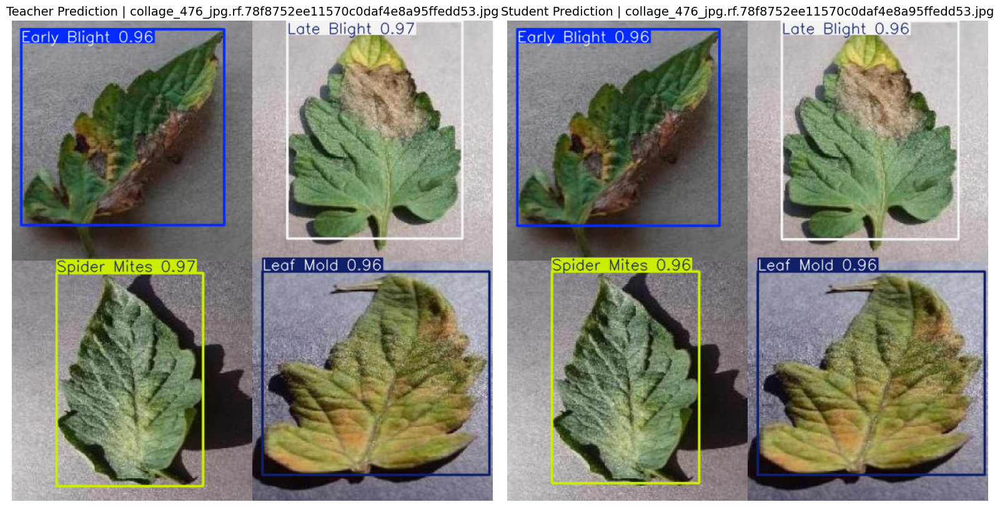


image 1/1 /kaggle/working/tomato_dataset/Tomato leaf diseases dataset for Object Detection/Dataset with augmentation/test/images/collage_1048_jpg.rf.f70d5bc7fbabb926ae32b302067c6df1.jpg: 640x640 1 Late Blight, 1 Leaf Miner, 1 Mosaic Virus, 1 Septoria, 15.9ms
Speed: 1.6ms preprocess, 15.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /kaggle/working/tomato_dataset/Tomato leaf diseases dataset for Object Detection/Dataset with augmentation/test/images/collage_1048_jpg.rf.f70d5bc7fbabb926ae32b302067c6df1.jpg: 640x640 1 Late Blight, 1 Leaf Miner, 1 Mosaic Virus, 1 Septoria, 14.3ms
Speed: 1.4ms preprocess, 14.3ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


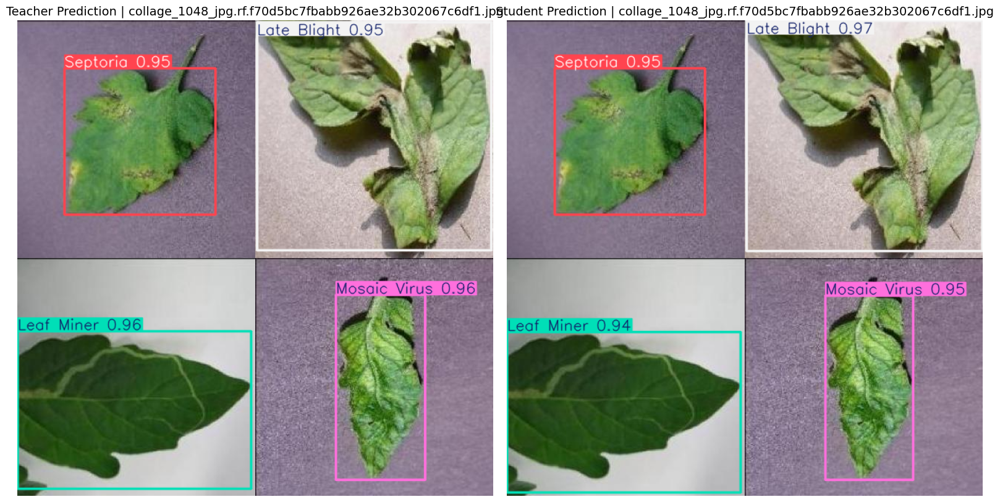


image 1/1 /kaggle/working/tomato_dataset/Tomato leaf diseases dataset for Object Detection/Dataset with augmentation/test/images/Worm-20_jpg.rf.5f2ac1e3fa1550a4fb1a290ace5e7798.jpg: 640x640 1 Leaf Miner, 17.3ms
Speed: 1.9ms preprocess, 17.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /kaggle/working/tomato_dataset/Tomato leaf diseases dataset for Object Detection/Dataset with augmentation/test/images/Worm-20_jpg.rf.5f2ac1e3fa1550a4fb1a290ace5e7798.jpg: 640x640 1 Leaf Miner, 14.6ms
Speed: 1.4ms preprocess, 14.6ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


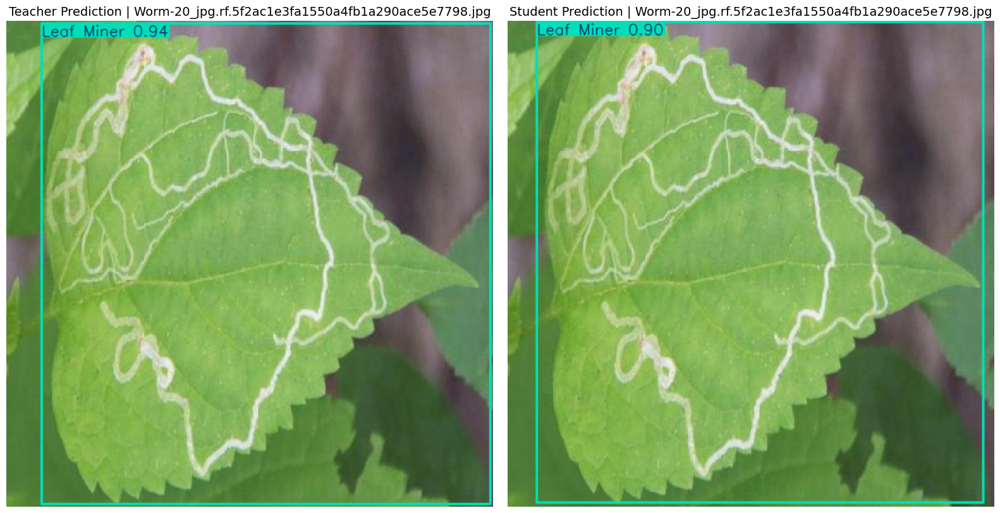


image 1/1 /kaggle/working/tomato_dataset/Tomato leaf diseases dataset for Object Detection/Dataset with augmentation/test/images/V001_tom1_39_012_a4_00_20210930_14_00122437_49122255_png_jpg.rf.0466f9b099a9abde404eb74d4c778f49.jpg: 640x640 11 Healthys, 15.3ms
Speed: 1.6ms preprocess, 15.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /kaggle/working/tomato_dataset/Tomato leaf diseases dataset for Object Detection/Dataset with augmentation/test/images/V001_tom1_39_012_a4_00_20210930_14_00122437_49122255_png_jpg.rf.0466f9b099a9abde404eb74d4c778f49.jpg: 640x640 10 Healthys, 15.0ms
Speed: 1.3ms preprocess, 15.0ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


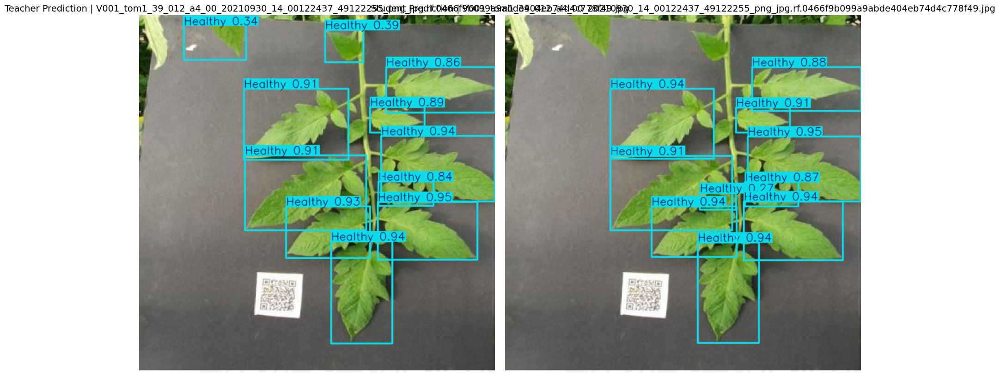


image 1/1 /kaggle/working/tomato_dataset/Tomato leaf diseases dataset for Object Detection/Dataset with augmentation/test/images/collage_1168_jpg.rf.13c6a94eddc62198cc1bca074a8b77d8.jpg: 640x640 1 Late Blight, 1 Leaf Miner, 1 Septoria, 1 Yellow Leaf Curl Virus, 15.3ms
Speed: 1.6ms preprocess, 15.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /kaggle/working/tomato_dataset/Tomato leaf diseases dataset for Object Detection/Dataset with augmentation/test/images/collage_1168_jpg.rf.13c6a94eddc62198cc1bca074a8b77d8.jpg: 640x640 1 Late Blight, 1 Leaf Miner, 1 Septoria, 1 Yellow Leaf Curl Virus, 14.5ms
Speed: 1.4ms preprocess, 14.5ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


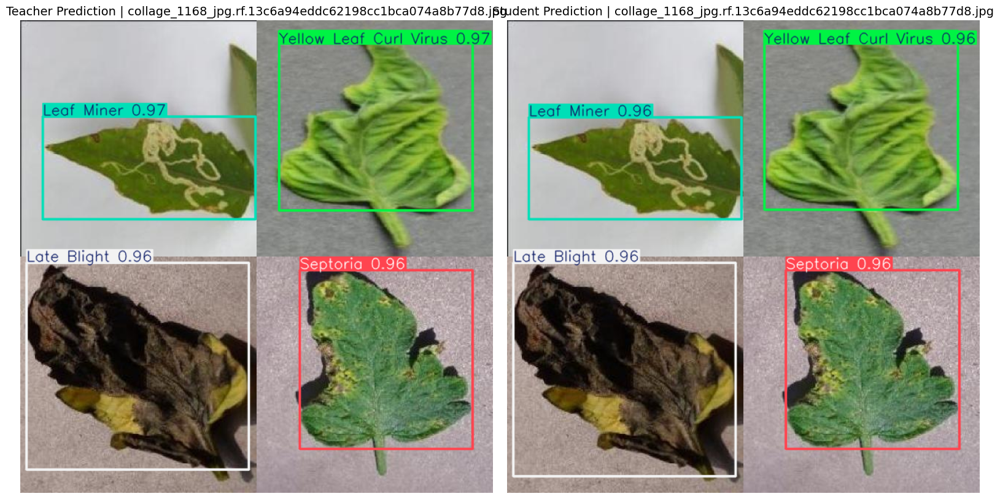

In [13]:
# ------------------------------------------------------------
# 8️⃣ Visualize Random Test Predictions (Teacher & Student)
# ------------------------------------------------------------
import random
import cv2
import matplotlib.pyplot as plt
from pathlib import Path
from ultralytics import YOLO

# ------------------------------------------------------------
# Load models
# ------------------------------------------------------------
TEACHER_BEST = "/kaggle/working/tomato_yolov12_train/teacher/weights/best.pt"
STUDENT_BEST = "/kaggle/working/2_student/student/weights/best.pt"

teacher_model = YOLO(TEACHER_BEST)
student_model = YOLO(STUDENT_BEST)

# ------------------------------------------------------------
# Test images directory
# ------------------------------------------------------------
test_img_dir = Path(dataset_root) / "test" / "images"

# Load test images
test_images = list(test_img_dir.glob("*.jpg")) + list(test_img_dir.glob("*.png"))

if len(test_images) == 0:
    print(f"⚠️ No test images found in: {test_img_dir}")

else:
    num_samples = min(5, len(test_images))
    random.seed(42)
    sample_images = random.sample(test_images, num_samples)

    print(f"🔍 Showing {num_samples} random test predictions (Teacher vs Student)\n")

    for i, img_path in enumerate(sample_images):

        # ------------------------------------------------------------
        # Teacher prediction
        # ------------------------------------------------------------
        teacher_results = teacher_model(img_path)
        teacher_img = teacher_results[0].plot()

        # ------------------------------------------------------------
        # Student prediction
        # ------------------------------------------------------------
        student_results = student_model(img_path)
        student_img = student_results[0].plot()

        # ------------------------------------------------------------
        # Display side-by-side
        # ------------------------------------------------------------
        plt.figure(figsize=(16, 8))

        plt.subplot(1, 2, 1)
        plt.imshow(cv2.cvtColor(teacher_img, cv2.COLOR_BGR2RGB))
        plt.title(f"Teacher Prediction | {img_path.name}", fontsize=14)
        plt.axis("off")

        plt.subplot(1, 2, 2)
        plt.imshow(cv2.cvtColor(student_img, cv2.COLOR_BGR2RGB))
        plt.title(f"Student Prediction | {img_path.name}", fontsize=14)
        plt.axis("off")

        plt.tight_layout()
        plt.show()



## 🧠 Explainable AI: Feature Activation Maps (Teacher vs Student)

This step provides a **visual interpretability analysis** of the YOLOv12 models by showing **feature activation overlays** for each class.

**Process**
1. Selects one representative test image per class
2. For each image:
   - Shows the **original image**
   - Teacher model:
     - Predicted bounding boxes (`Teacher Prediction`)
     - Feature activation heatmap overlay (`Teacher XAI`)
   - Student model:
     - Predicted bounding boxes (`Student Prediction`)
     - Feature activation heatmap overlay (`Student XAI`)
3. Feature activations are extracted from a late convolutional layer and mapped to a heatmap over the image

**Purpose**
- Visualizes which regions of the image the models focus on for object detection
- Compares attention patterns between teacher and student
- Identifies potential model biases or misfocus areas
- Enhances trust and interpretability of the semi-supervised learning approach

**Outcome**
- Side-by-side plots per class: Original | Teacher Prediction | Teacher XAI | Student Prediction | Student XAI
- Clear visual comparison of model attention and prediction behavior



🎯 Found examples for 9 / 9 classes.

image 1/1 /kaggle/working/tomato_dataset/Tomato leaf diseases dataset for Object Detection/Dataset with augmentation/test/images/collage_1387_jpg.rf.43c9131373c63a0d69884013029124ac.jpg: 640x640 1 Early Blight, 1 Late Blight, 1 Mosaic Virus, 1 Septoria, 13.8ms
Speed: 1.5ms preprocess, 13.8ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /kaggle/working/tomato_dataset/Tomato leaf diseases dataset for Object Detection/Dataset with augmentation/test/images/collage_1387_jpg.rf.43c9131373c63a0d69884013029124ac.jpg: 640x640 1 Early Blight, 1 Late Blight, 1 Mosaic Virus, 1 Septoria, 13.6ms
Speed: 1.4ms preprocess, 13.6ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /kaggle/working/tomato_dataset/Tomato leaf diseases dataset for Object Detection/Dataset with augmentation/test/images/collage_1034_jpg.rf.0fb71f21e31e8f895c6b0b12be0ae05e.jpg: 640x640 1 Early Blight, 1 Healthy, 1 Mosaic Virus, 1 Septo

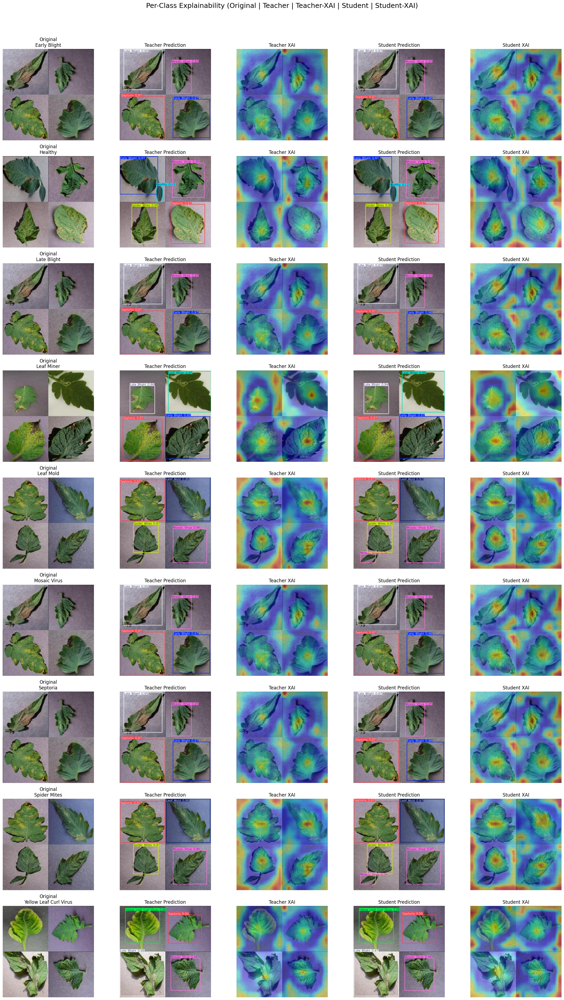

In [14]:
# ------------------------------------------------------------
# 9️⃣ Explainability: Feature Activation Map (XAI)
#     Teacher vs Student
# ------------------------------------------------------------
import cv2
import torch
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from collections import defaultdict
from ultralytics import YOLO

# ------------------------------------------------------------
# Load models
# ------------------------------------------------------------
TEACHER_BEST = "/kaggle/working/tomato_yolov12_train/teacher/weights/best.pt"
STUDENT_BEST = "/kaggle/working/2_student/student/weights/best.pt"

teacher_model = YOLO(TEACHER_BEST)
student_model = YOLO(STUDENT_BEST)

# ------------------------------------------------------------
# Get test images and labels
# ------------------------------------------------------------
test_img_dir = Path(dataset_root) / "test" / "images"
test_lbl_dir = Path(dataset_root) / "test" / "labels"

# Map: class_id → (img_path, label_parts)
class_to_examples = defaultdict(list)

for lbl_path in test_lbl_dir.glob("*.txt"):
    img_path = test_img_dir / f"{lbl_path.stem}.jpg"
    if not img_path.exists():
        img_path = test_img_dir / f"{lbl_path.stem}.png"
    if not img_path.exists():
        continue

    with open(lbl_path, "r") as f:
        for line in f:
            parts = line.strip().split()
            if len(parts) < 5:
                continue

            cls_id = int(float(parts[0]))

            if len(class_to_examples[cls_id]) == 0:
                class_to_examples[cls_id].append((img_path, list(map(float, parts))))

# Collect one example per class
examples_per_class = []
for i in range(len(class_names)):
    if i in class_to_examples:
        examples_per_class.append(class_to_examples[i][0])

print(f"🎯 Found examples for {len(examples_per_class)} / {len(class_names)} classes.")

# ------------------------------------------------------------
# Feature activation extraction (YOLOv12-safe)
# ------------------------------------------------------------
def get_activation_overlay(model, img_path, layer_idx=-2):
    model.model.eval()

    img = cv2.imread(str(img_path))
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    h, w = img.shape[:2]

    resized = cv2.resize(img_rgb, (640, 640))
    input_tensor = (
        torch.from_numpy(resized)
        .float()
        .permute(2, 0, 1)
        .unsqueeze(0)
        .to(model.device) / 255.0
    )

    activation = {}

    layers = list(model.model.model.children())
    layer_idx = layer_idx if layer_idx > -len(layers) else -1

    def hook(_, __, output):
        activation["feat"] = output.detach()

    handle = layers[layer_idx].register_forward_hook(hook)

    with torch.no_grad():
        _ = model.model(input_tensor)

    handle.remove()

    feat = activation["feat"].cpu().mean(dim=1).squeeze().numpy()
    feat = (feat - feat.min()) / (feat.max() - feat.min() + 1e-8)
    feat = cv2.resize(feat, (w, h))

    heatmap = cv2.applyColorMap(np.uint8(255 * feat), cv2.COLORMAP_JET)
    overlay = cv2.addWeighted(img, 0.6, heatmap, 0.4, 0)

    return overlay

# ------------------------------------------------------------
# Plot: Original | Teacher | Teacher-XAI | Student | Student-XAI
# ------------------------------------------------------------
rows = len(examples_per_class)
plt.figure(figsize=(22, 4 * rows))

for idx, (img_path, label_parts) in enumerate(examples_per_class):
    cls_id = int(label_parts[0])
    class_name = class_names[cls_id]

    # Original
    orig = cv2.cvtColor(cv2.imread(str(img_path)), cv2.COLOR_BGR2RGB)

    # Teacher
    t_pred = teacher_model(img_path)[0]
    t_img = cv2.cvtColor(t_pred.plot(), cv2.COLOR_BGR2RGB)
    t_xai = cv2.cvtColor(get_activation_overlay(teacher_model, img_path), cv2.COLOR_BGR2RGB)

    # Student
    s_pred = student_model(img_path)[0]
    s_img = cv2.cvtColor(s_pred.plot(), cv2.COLOR_BGR2RGB)
    s_xai = cv2.cvtColor(get_activation_overlay(student_model, img_path), cv2.COLOR_BGR2RGB)

    # ---- Plot row ----
    base = idx * 5
    plt.subplot(rows, 5, base + 1)
    plt.imshow(orig)
    plt.title(f"Original\n{class_name}")
    plt.axis("off")

    plt.subplot(rows, 5, base + 2)
    plt.imshow(t_img)
    plt.title("Teacher Prediction")
    plt.axis("off")

    plt.subplot(rows, 5, base + 3)
    plt.imshow(t_xai)
    plt.title("Teacher XAI")
    plt.axis("off")

    plt.subplot(rows, 5, base + 4)
    plt.imshow(s_img)
    plt.title("Student Prediction")
    plt.axis("off")

    plt.subplot(rows, 5, base + 5)
    plt.imshow(s_xai)
    plt.title("Student XAI")
    plt.axis("off")

plt.suptitle(
    "Per-Class Explainability (Original | Teacher | Teacher-XAI | Student | Student-XAI)",
    fontsize=18,
    y=1.02
)
plt.tight_layout()
plt.show()

